In [2]:
#Importing libraries for 
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly_express as px

palette = sns.color_palette("rainbow",8)

import warnings
warnings.filterwarnings("ignore")

# 1. DATA EXPLORATION

In [3]:
df = pd.read_csv("/Users/pranalidarekar/Downloads/train.csv")

In [34]:
df.shape

(55423856, 8)

In [35]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 55423856 entries, 0 to 55423855
Data columns (total 8 columns):
 #   Column             Dtype  
---  ------             -----  
 0   key                object 
 1   fare_amount        float64
 2   pickup_datetime    object 
 3   pickup_longitude   float64
 4   pickup_latitude    float64
 5   dropoff_longitude  float64
 6   dropoff_latitude   float64
 7   passenger_count    int64  
dtypes: float64(5), int64(1), object(2)
memory usage: 3.3+ GB


In [36]:
df.head(10).style.set_properties(**{'background-color': 'pink','color': 'black','border':'black'})
# displaying first 10 rows of the data, also changed style so that it looks in a tabluar format

,key,fare_amount,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count
0,2009-06-15 17:26:21.0000001,4.500000,2009-06-15 17:26:21 UTC,-73.844311,40.721319,-73.841610,40.712278,1
1,2010-01-05 16:52:16.0000002,16.900000,2010-01-05 16:52:16 UTC,-74.016048,40.711303,-73.979268,40.782004,1
2,2011-08-18 00:35:00.00000049,5.700000,2011-08-18 00:35:00 UTC,-73.982738,40.761270,-73.991242,40.750562,2
3,2012-04-21 04:30:42.0000001,7.700000,2012-04-21 04:30:42 UTC,-73.987130,40.733143,-73.991567,40.758092,1
4,2010-03-09 07:51:00.000000135,5.300000,2010-03-09 07:51:00 UTC,-73.968095,40.768008,-73.956655,40.783762,1
5,2011-01-06 09:50:45.0000002,12.100000,2011-01-06 09:50:45 UTC,-74.000964,40.731630,-73.972892,40.758233,1
6,2012-11-20 20:35:00.0000001,7.500000,2012-11-20 20:35:00 UTC,-73.980002,40.751662,-73.973802,40.764842,1
7,2012-01-04 17:22:00.00000081,16.500000,2012-01-04 17:22:00 UTC,-73.951300,40.774138,-73.990095,40.751048,1
8,2012-12-03 13:10:00.000000125,9.000000,2012-12-03 13:10:00 UTC,-74.006462,40.726713,-73.993078,40.731628,1
9,2009-09-02 01:11:00.00000083,8.900000,2009-09-02 01:11:00 UTC,-73.980658,40.733873,-73.991540,40.758138,2


In [37]:
df.describe()
# using 'describe to get a knowledge about count, mean, SD etc

,fare_amount,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count
count,5.542386e+07,5.542386e+07,5.542386e+07,5.542348e+07,5.542348e+07,5.542386e+07
mean,1.134505e+01,-7.250968e+01,3.991979e+01,-7.251121e+01,3.992068e+01,1.685380e+00
std,2.071083e+01,1.284888e+01,9.642353e+00,1.278220e+01,9.633346e+00,1.327664e+00
min,-3.000000e+02,-3.442060e+03,-3.492264e+03,-3.442025e+03,-3.547887e+03,0.000000e+00
25%,6.000000e+00,-7.399207e+01,4.073493e+01,-7.399140e+01,4.073403e+01,1.000000e+00
50%,8.500000e+00,-7.398180e+01,4.075265e+01,-7.398015e+01,4.075316e+01,1.000000e+00
75%,1.250000e+01,-7.396708e+01,4.076713e+01,-7.396367e+01,4.076810e+01,2.000000e+00
max,9.396336e+04,3.457626e+03,3.408790e+03,3.457622e+03,3.537133e+03,2.080000e+02


In [38]:
# checking for null values
df.isnull().sum()

key                    0
fare_amount            0
pickup_datetime        0
pickup_longitude       0
pickup_latitude        0
dropoff_longitude    376
dropoff_latitude     376
passenger_count        0
dtype: int64

In [40]:
duplicates = df.duplicated

In [41]:
# Finding null values
df.isnull().sum()

key                    0
fare_amount            0
pickup_datetime        0
pickup_longitude       0
pickup_latitude        0
dropoff_longitude    376
dropoff_latitude     376
passenger_count        0
dtype: int64

2.** Feature Engineering**

As we know the data set is large consisting of 55423856 rows & 8 column, Let take a random sample of 10000

In [42]:
# 2.1 Lets take random sample

rs_df = df.sample(100000)


In [43]:
rs_df.head()

,key,fare_amount,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count
40725939,2013-11-18 20:42:56.0000001,9.5,2013-11-18 20:42:56 UTC,-73.993460,40.747014,-73.983611,40.769637,1
27244706,2009-10-01 22:48:21.0000002,8.5,2009-10-01 22:48:21 UTC,-73.988321,40.731867,-74.016066,40.704983,1
25858741,2014-02-08 19:31:00.000000192,11.5,2014-02-08 19:31:00 UTC,-73.982400,40.772720,-73.948050,40.776180,1
33373967,2013-11-23 11:08:00.00000070,13.5,2013-11-23 11:08:00 UTC,-73.952970,40.782950,-73.973872,40.743920,2
48641346,2010-09-25 04:21:00.0000005,16.5,2010-09-25 04:21:00 UTC,-73.999323,40.731335,-73.939867,40.798025,5


In [44]:
# 2.2 Now let's separate DATE,TIME & HOUR from the pickup time
rs_df['pickup_datetime']= pd.to_datetime(rs_df['pickup_datetime'], format= "%Y-%m-%d %H:%M:%S UTC")

# Creating new column for year,weekday,hour in rs_df dataframe
rs_df['Year'] = rs_df.pickup_datetime.apply(lambda t: t.year)
rs_df['Weekday'] = rs_df.pickup_datetime.apply(lambda t: t.weekday())
rs_df['Hour'] = rs_df.pickup_datetime.apply(lambda t: t.hour)


In [45]:
rs_df.shape
rs_df.head(10)

,key,fare_amount,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,Year,Weekday,Hour
40725939,2013-11-18 20:42:56.0000001,9.5,2013-11-18 20:42:56,-73.993460,40.747014,-73.983611,40.769637,1,2013,0,20
27244706,2009-10-01 22:48:21.0000002,8.5,2009-10-01 22:48:21,-73.988321,40.731867,-74.016066,40.704983,1,2009,3,22
25858741,2014-02-08 19:31:00.000000192,11.5,2014-02-08 19:31:00,-73.982400,40.772720,-73.948050,40.776180,1,2014,5,19
33373967,2013-11-23 11:08:00.00000070,13.5,2013-11-23 11:08:00,-73.952970,40.782950,-73.973872,40.743920,2,2013,5,11
48641346,2010-09-25 04:21:00.0000005,16.5,2010-09-25 04:21:00,-73.999323,40.731335,-73.939867,40.798025,5,2010,5,4
41441066,2013-07-08 19:38:33.0000001,7.5,2013-07-08 19:38:33,-73.971378,40.758997,-73.982829,40.758259,1,2013,0,19
18197409,2010-10-26 21:58:00.000000184,12.9,2010-10-26 21:58:00,-73.996568,40.723722,-73.957590,40.773828,5,2010,1,21
27706108,2014-02-17 16:53:00.000000108,9.5,2014-02-17 16:53:00,-73.979530,40.758440,-73.981345,40.737105,1,2014,0,16
19208513,2011-11-25 08:28:00.00000051,4.9,2011-11-25 08:28:00,-73.963650,40.763462,-73.956905,40.774817,1,2011,4,8
30180093,2012-10-01 08:39:56.0000005,4.5,2012-10-01 08:39:56,-73.972265,40.753520,-73.966204,40.761973,1,2012,0,8


In [46]:
# 2.3 Let's Findout the DISTANCE(miles) from the pickup and dropof latitudes and longitudes
# Calculate the distance in miles between locations in lon,lat coordinates using haversine formula

def distance(lat1, lon1, lat2, lon2):
    
    p = 0.017453292519943295 # Pi/180
    a = 0.5 - np.cos((lat2 - lat1) * p)/2 + np.cos(lat1 * p) * np.cos(lat2 * p) * (1 - np.cos((lon2 - lon1) * p)) / 2
    return 0.6213712 * 12742 * np.arcsin(np.sqrt(a)) # 2*R*asin...

rs_df['distance']= distance(rs_df.pickup_latitude, rs_df.pickup_longitude, rs_df.dropoff_latitude, rs_df.dropoff_longitude)

In [47]:
rs_df.head(10)

,key,fare_amount,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,Year,Weekday,Hour,distance
40725939,2013-11-18 20:42:56.0000001,9.5,2013-11-18 20:42:56,-73.993460,40.747014,-73.983611,40.769637,1,2013,0,20,1.645896
27244706,2009-10-01 22:48:21.0000002,8.5,2009-10-01 22:48:21,-73.988321,40.731867,-74.016066,40.704983,1,2009,3,22,2.358252
25858741,2014-02-08 19:31:00.000000192,11.5,2014-02-08 19:31:00,-73.982400,40.772720,-73.948050,40.776180,1,2014,5,19,1.813139
33373967,2013-11-23 11:08:00.00000070,13.5,2013-11-23 11:08:00,-73.952970,40.782950,-73.973872,40.743920,2,2013,5,11,2.910113
48641346,2010-09-25 04:21:00.0000005,16.5,2010-09-25 04:21:00,-73.999323,40.731335,-73.939867,40.798025,5,2010,5,4,5.559940
41441066,2013-07-08 19:38:33.0000001,7.5,2013-07-08 19:38:33,-73.971378,40.758997,-73.982829,40.758259,1,2013,0,19,0.601464
18197409,2010-10-26 21:58:00.000000184,12.9,2010-10-26 21:58:00,-73.996568,40.723722,-73.957590,40.773828,5,2010,1,21,4.018457
27706108,2014-02-17 16:53:00.000000108,9.5,2014-02-17 16:53:00,-73.979530,40.758440,-73.981345,40.737105,1,2014,0,16,1.477164
19208513,2011-11-25 08:28:00.00000051,4.9,2011-11-25 08:28:00,-73.963650,40.763462,-73.956905,40.774817,1,2011,4,8,0.860290
30180093,2012-10-01 08:39:56.0000005,4.5,2012-10-01 08:39:56,-73.972265,40.753520,-73.966204,40.761973,1,2012,0,8,0.664630


3. DATA CLEANING

In [48]:
# 3.1 Removing the columns with null values from rs_df
rs_df = rs_df.dropna()

In [49]:
# 3.2 Removing fare prices less than zero
rs_df = rs_df[rs_df.fare_amount > 0]

In [50]:
# 3.3 Removing distances less than zero
rs_df = rs_df[rs_df.distance > 0]

In [51]:
# Removing the key and pickup_datatime from dataset
# As we already got the date and time from the pickup_datetime, so we now no longer need them

rs_df = rs_df.drop(['key','pickup_datetime'], axis = 1)

In [52]:
rs_df.head(10)

,fare_amount,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,Year,Weekday,Hour,distance
40725939,9.5,-73.993460,40.747014,-73.983611,40.769637,1,2013,0,20,1.645896
27244706,8.5,-73.988321,40.731867,-74.016066,40.704983,1,2009,3,22,2.358252
25858741,11.5,-73.982400,40.772720,-73.948050,40.776180,1,2014,5,19,1.813139
33373967,13.5,-73.952970,40.782950,-73.973872,40.743920,2,2013,5,11,2.910113
48641346,16.5,-73.999323,40.731335,-73.939867,40.798025,5,2010,5,4,5.559940
41441066,7.5,-73.971378,40.758997,-73.982829,40.758259,1,2013,0,19,0.601464
18197409,12.9,-73.996568,40.723722,-73.957590,40.773828,5,2010,1,21,4.018457
27706108,9.5,-73.979530,40.758440,-73.981345,40.737105,1,2014,0,16,1.477164
19208513,4.9,-73.963650,40.763462,-73.956905,40.774817,1,2011,4,8,0.860290
30180093,4.5,-73.972265,40.753520,-73.966204,40.761973,1,2012,0,8,0.664630


4. DATA VISUALIZATION

In [53]:
rs_df.head(20)

,fare_amount,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,Year,Weekday,Hour,distance
40725939,9.5,-73.993460,40.747014,-73.983611,40.769637,1,2013,0,20,1.645896
27244706,8.5,-73.988321,40.731867,-74.016066,40.704983,1,2009,3,22,2.358252
25858741,11.5,-73.982400,40.772720,-73.948050,40.776180,1,2014,5,19,1.813139
33373967,13.5,-73.952970,40.782950,-73.973872,40.743920,2,2013,5,11,2.910113
48641346,16.5,-73.999323,40.731335,-73.939867,40.798025,5,2010,5,4,5.559940
41441066,7.5,-73.971378,40.758997,-73.982829,40.758259,1,2013,0,19,0.601464
18197409,12.9,-73.996568,40.723722,-73.957590,40.773828,5,2010,1,21,4.018457
27706108,9.5,-73.979530,40.758440,-73.981345,40.737105,1,2014,0,16,1.477164
19208513,4.9,-73.963650,40.763462,-73.956905,40.774817,1,2011,4,8,0.860290
30180093,4.5,-73.972265,40.753520,-73.966204,40.761973,1,2012,0,8,0.664630


In [54]:
# 4.1 Visualize the geospatial locations for the pickup points

pickup_fig = px.scatter_mapbox(rs_df, lat = 'pickup_latitude', lon = 'pickup_longitude', hover_name = 'fare_amount'
,hover_data=['fare_amount']
,color = 'fare_amount', color_continuous_scale=px.colors.sequential.Agsunset, opacity =0.10,
center = {'lat': 40.75, 'lon': -73.984},
zoom = 11, height = 500, width= 1180,
mapbox_style="carto-positron", labels= None)

pickup_fig.update_layout(margin={"r": 0,"t": 0,"l": 0,"b": 0}).update_coloraxes(showscale=False)

pickup_fig.show()



In [55]:
# 4.2 Visualize the geospatial locations for the dropoff points

dropoff_fig = px.scatter_mapbox(rs_df, lat='dropoff_latitude',lon='dropoff_longitude', hover_name= 'fare_amount'
, hover_data=['fare_amount'], color= 'fare_amount', color_continuous_scale= px.colors.sequential.Rainbow_r, opacity= 0.05,
center = {'lat': 40.75, 'lon': -73.984},
zoom = 11, height = 500, width= 1180,
mapbox_style="carto-positron", labels= None)

pickup_fig.update_layout(margin={"r": 0,"t": 0,"l": 0,"b": 0}).update_coloraxes(showscale=False)

dropoff_fig.show()                            

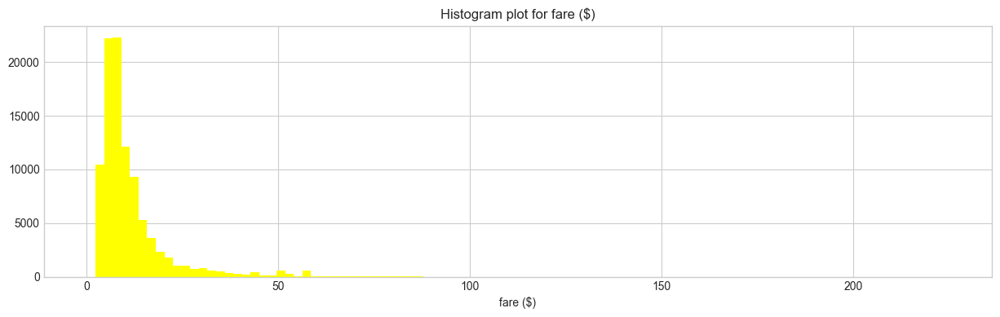

In [56]:
# 4.3 Histogram plot of fare price
plt.style.use('seaborn-whitegrid')
plt.figure(figsize=(15,4))

plt.hist(rs_df['fare_amount'], bins=100, color= 'yellow')
plt.xlabel('fare ($)')
plt.title("Histogram plot for fare ($)")

plt.show()


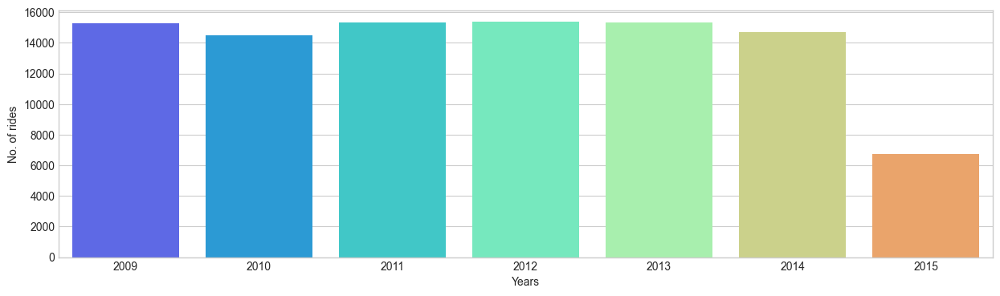

In [57]:
# 4.4 Barplot for visualizing the number of rides in the following years

year_insight = rs_df.Year.value_counts()

plt.figure(figsize=(15,4))
sns.barplot(data = rs_df , x= year_insight.index, y= year_insight.values, palette=palette)
plt.ylabel("No. of rides")
plt.xlabel("Years")
plt.show()



In [58]:
# 4.4.a Traffic in year 2012

year2012_insight= rs_df[rs_df['Year']== 2012]
year2012_insight

,fare_amount,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,Year,Weekday,Hour,distance
30180093,4.5,-73.972265,40.753520,-73.966204,40.761973,1,2012,0,8,0.664630
26925066,5.3,-73.953638,40.775767,-73.963738,40.761857,2,2012,3,23,1.096820
35674234,4.9,-73.991905,40.735237,-74.003725,40.726967,1,2012,0,21,0.842316
27766060,7.5,-73.974872,40.787657,-73.955007,40.779310,1,2012,2,22,1.188561
46023523,6.5,-73.952943,40.780545,-73.967833,40.792370,2,2012,6,0,1.128852
...,...,...,...,...,...,...,...,...,...,...
24457745,5.3,-73.965322,40.769192,-73.956322,40.784017,5,2012,2,16,1.127364
45096087,4.5,-73.975495,40.753636,-73.981634,40.749908,1,2012,2,13,0.411820
23771244,5.3,-73.980292,40.753992,-73.980107,40.745805,1,2012,5,17,0.565750
40077936,20.5,-73.979089,40.756716,-73.954815,40.689031,1,2012,1,15,4.846243


In [59]:
xlim = [-74.03, -73.85]
ylim = [40.70, 40.85]


year2012_traffic_insight = year2012_insight.copy()
year2012_insight = year2012_insight[(year2012_insight.pickup_longitude > xlim[0]) & (year2012_insight.pickup_longitude < xlim[1])]
year2012_insight = year2012_insight[(year2012_insight.dropoff_longitude > xlim[0]) & (year2012_insight.dropoff_longitude < xlim[1])]
year2012_insight = year2012_insight[(year2012_insight.pickup_latitude > ylim[0]) & (year2012_insight.pickup_latitude < ylim[1])]
year2012_insight = year2012_insight[(year2012_insight.dropoff_latitude > ylim[0]) & (year2012_insight.dropoff_latitude < ylim[1])]


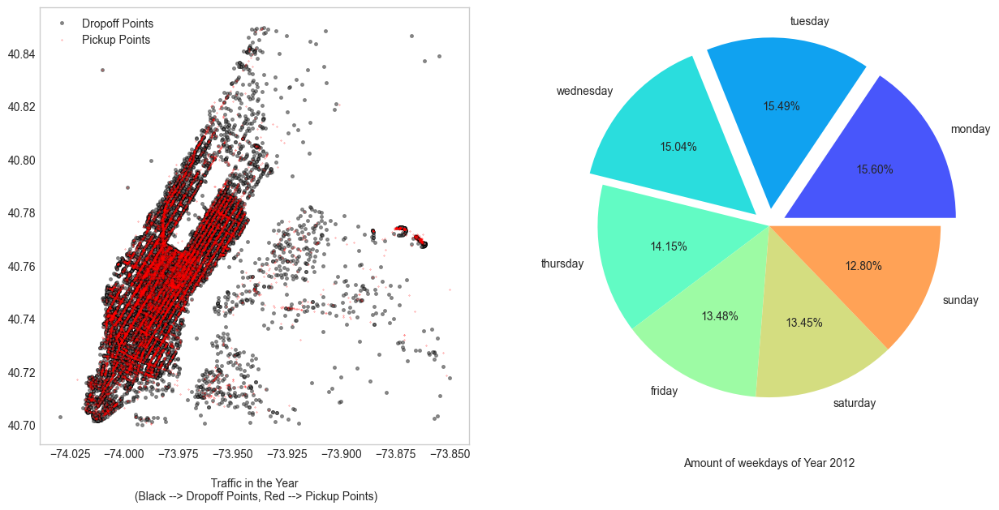

In [61]:
plt.figure(figsize=(15,7))

plt.subplot(1,2,1)

plt.plot(year2012_insight.dropoff_longitude, year2012_insight.dropoff_latitude, 'o', alpha = 0.5, 
markersize= 2, color="#fff", markeredgecolor= '#000', markeredgewidth= 1.5)
plt.plot(year2012_insight.pickup_longitude, year2012_insight.pickup_latitude, '.', alpha= 0.8,
markersize= 0.5,color= "red")
plt.legend(['Dropoff Points', 'Pickup Points'])
plt.xlabel("\n Traffic in the Year \n (Black --> Dropoff Points, Red --> Pickup Points)")
plt.grid(False)


plt.subplot(1, 2, 2)

days_list = {'monday' : 0, 'tuesday' : 1, 'wednesday' : 2, 'thursday' : 3, 'friday' : 4, 'saturday' : 5, 'sunday' : 6}
weeklyTraffic = year2012_insight['Weekday'].value_counts()
plt.pie(weeklyTraffic.values, labels=days_list, autopct="%.2f%%", explode=[0.1, 0.1, 0.1, 0, 0, 0, 0], colors=palette)
plt.xlabel("\nAmount of weekdays of Year 2012")
plt.show()


plt.show()




In [30]:
print(year2012_insight[['pickup_longitude', 'pickup_latitude', 'dropoff_longitude', 'dropoff_latitude']].describe())


       pickup_longitude  pickup_latitude  dropoff_longitude  dropoff_latitude
count      14376.000000     14376.000000       14376.000000      14376.000000
mean         -73.979022        40.753839         -73.977247         40.754687
std            0.022846         0.021819           0.024307          0.023522
min          -74.027097        40.700543         -74.028270         40.700201
25%          -73.992479        40.738945         -73.991813         40.739398
50%          -73.982220        40.754914         -73.980987         40.755182
75%          -73.969436        40.768079         -73.967193         40.769145
max          -73.853172        40.849633         -73.850832         40.849662


In [31]:
print(year2012_insight[['pickup_longitude', 'pickup_latitude', 'dropoff_longitude', 'dropoff_latitude']].isna().sum())


pickup_longitude     0
pickup_latitude      0
dropoff_longitude    0
dropoff_latitude     0
dtype: int64


In [32]:
out_of_bounds = year2012_insight[(year2012_insight['pickup_longitude'] < -180) | 
                                 (year2012_insight['pickup_longitude'] > 180) |
                                 (year2012_insight['pickup_latitude'] < -90) | 
                                 (year2012_insight['pickup_latitude'] > 90) |
                                 (year2012_insight['dropoff_longitude'] < -180) | 
                                 (year2012_insight['dropoff_longitude'] > 180) |
                                 (year2012_insight['dropoff_latitude'] < -90) | 
                                 (year2012_insight['dropoff_latitude'] > 90)]

print(out_of_bounds)


Empty DataFrame
Columns: [fare_amount, pickup_longitude, pickup_latitude, dropoff_longitude, dropoff_latitude, passenger_count, Year, Weekday, Hour, distance]
Index: []


In [33]:
# Removing outliers
year2012_insight = year2012_insight[~((year2012_insight['pickup_longitude'] < -180) | 
                                              (year2012_insight['pickup_longitude'] > 180) |
                                              (year2012_insight['pickup_latitude'] < -90) | 
                                              (year2012_insight['pickup_latitude'] > 90) |
                                              (year2012_insight['dropoff_longitude'] < -180) | 
                                              (year2012_insight['dropoff_longitude'] > 180) |
                                              (year2012_insight['dropoff_latitude'] < -90) | 
                                              (year2012_insight['dropoff_latitude'] > 90))]


In [62]:
#  Clustering on geographic locations (dropoff points) of taxi rides from the year 2012 using the KMeans clustering algorithm from scikit-learn, and then visualizes these clusters on a plot.
from sklearn.cluster import KMeans
from sklearn.neighbors import KNeighborsClassifier

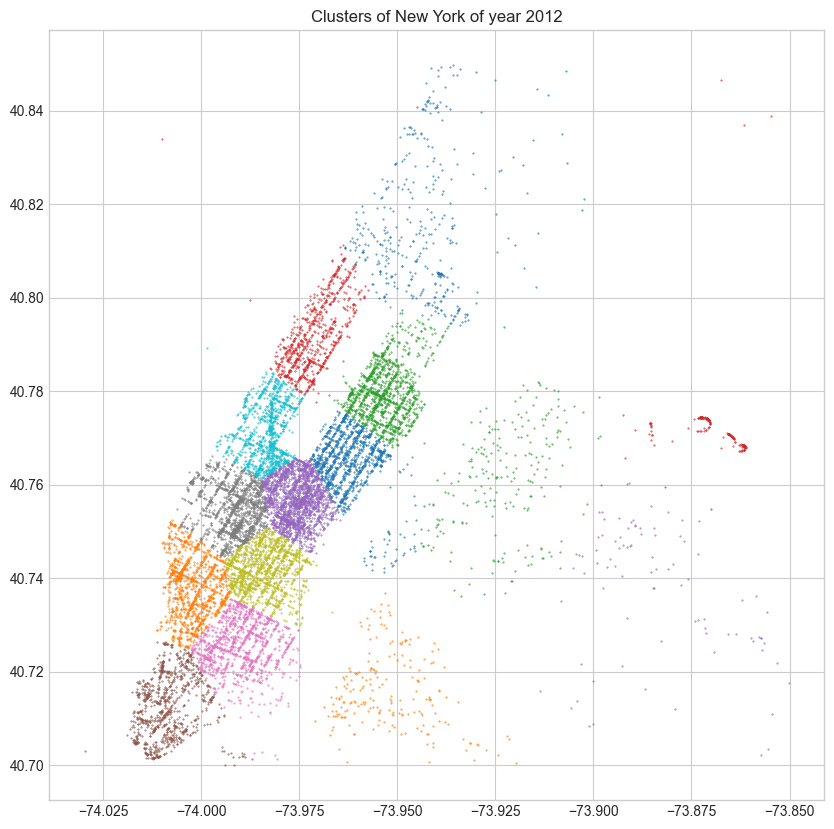

In [63]:
#Create a DataFrame for Location Data
loc_df = pd.DataFrame()

#Populate DataFrame with Longitude and Latitude
loc_df['longitude'] = year2012_insight.dropoff_longitude
loc_df['latitude'] = year2012_insight.dropoff_latitude

#Initialize and Fit KMeans
kmeans = KMeans(n_clusters=15, random_state=2, n_init = 10).fit(loc_df)

# Assign Cluster Labels
loc_df['label'] = kmeans.labels_

# Set Up the Plot
plt.figure(figsize = (10, 10))
for label in loc_df.label.unique():
    plt.plot(loc_df.longitude[loc_df.label == label],loc_df.latitude[loc_df.label == label],'.', alpha = 1, markersize = 0.8)

#Add Title and Show Plot
plt.title('Clusters of New York of year 2012')
plt.show()

In [70]:
# 4. 4. b. Lets see the peaks days with their rush hours of year 2012

def visualize_peakDaysF(day, color='r'):
    year2012_monday_insight = year2012_insight[year2012_insight["Weekday"] == day]
    day_name = list(days_list.keys())[day]
    plt.figure(figsize = (15, 70))
    
    max_pickup, max_pgcnt = 0, 0
    
    for hrs in range(24):
        specDay_traffic = year2012_monday_insight[year2012_monday_insight['Hour'] == hrs]
        pickup = len(specDay_traffic)
        pgn_cnt = specDay_traffic["passenger_count"].sum()
        
        
        max_pickup = max(max_pickup, pickup)
        max_pgcnt = max(max_pgcnt, pgn_cnt)


        longitude = list(specDay_traffic.pickup_longitude) + list(specDay_traffic.dropoff_longitude)
        latitude = list(specDay_traffic.pickup_latitude) + list(specDay_traffic.dropoff_latitude)
        plt.subplot(24, 6, hrs+1)

        plt.title("\nHour: " + str(hrs) + " [pickup="+ str(pickup)+",\npassengers count="+ str(pgn_cnt)+"] ", fontsize=12)

        plt.grid(False)
        plt.xticks([])
        plt.yticks([])
        plt.plot(longitude,latitude,'.', alpha = 0.6, markersize = 10, color=color)

#         break
    plt.suptitle("\n"+ day_name.capitalize() +" (max pickups=" + str(max_pickup) + ", max passengers=" + str(max_pgcnt) + ")\n\n\n\n\n\n", fontsize=20)
    plt.tight_layout()
    plt.show()



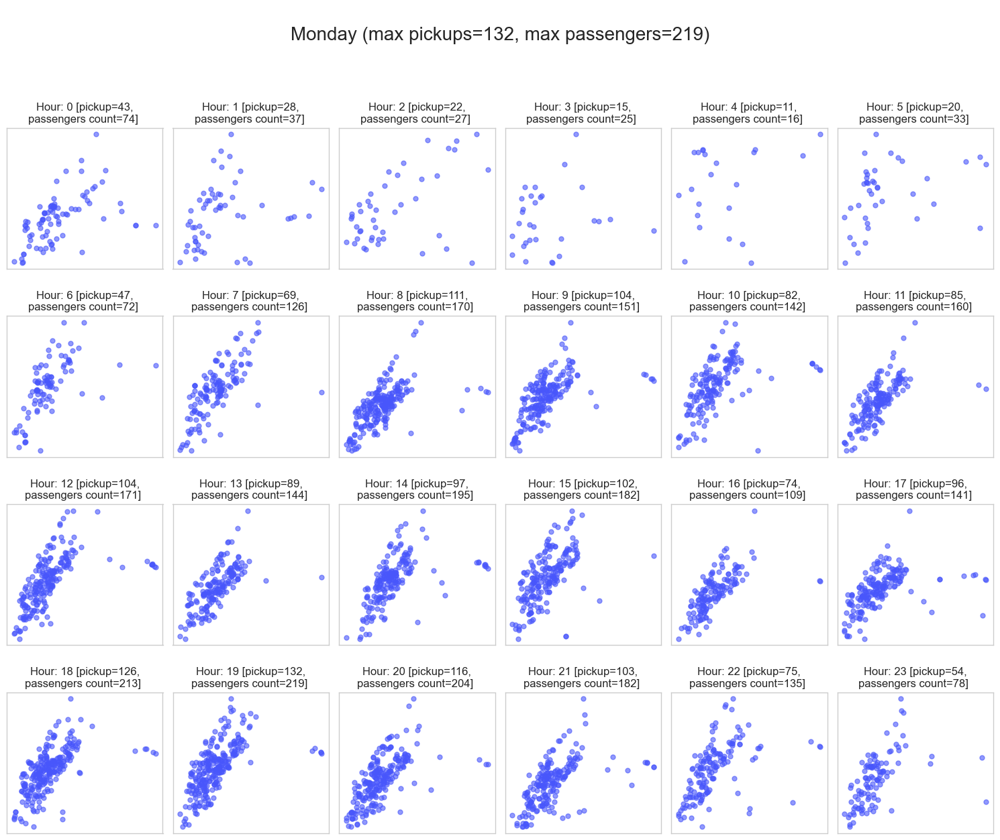

In [71]:
# 4. 4. b1. Visualize the rush hours for monday
visualize_peakDaysF(0, color='#4856fb')

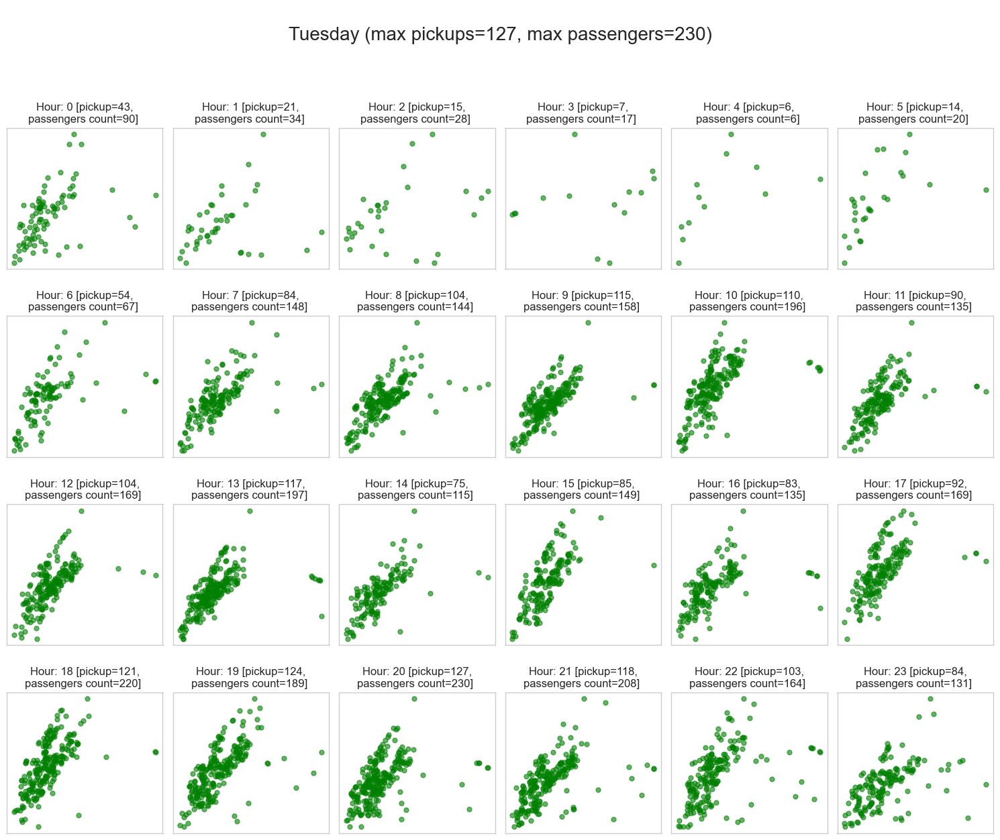

In [74]:
# 4. 4. b2. Visualize the rush hours for tuesday

visualize_peakDaysF(1, color='green')

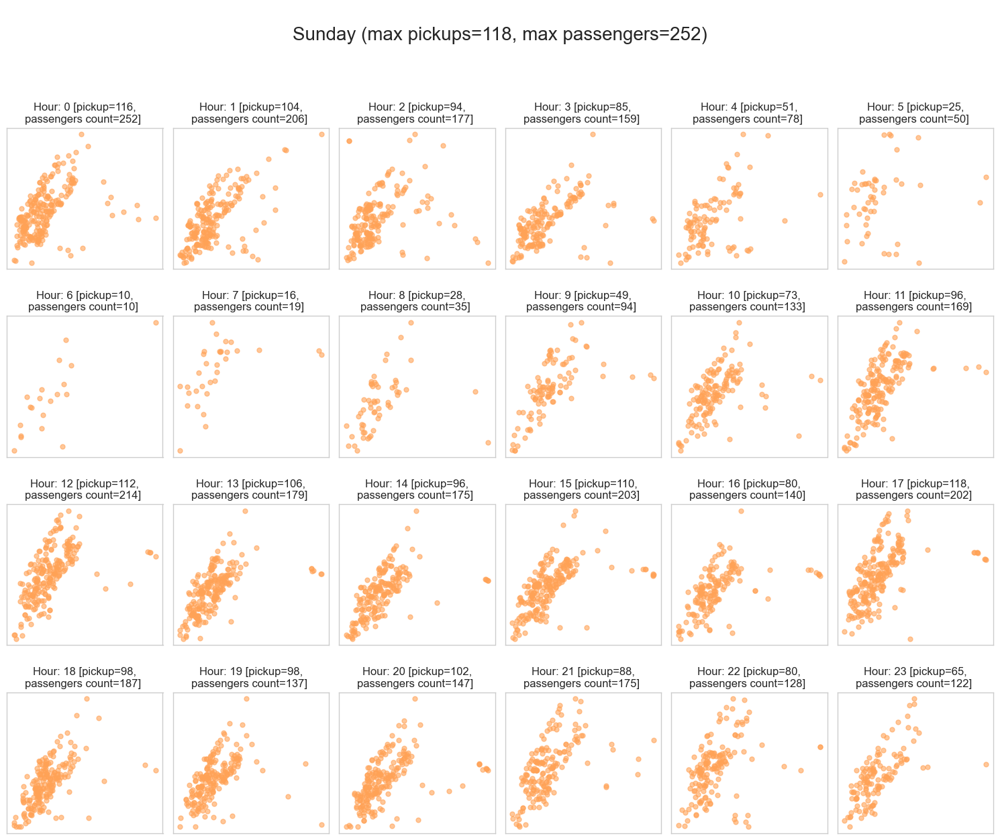

In [75]:
# 4. 4. b3. Visualize the rush hours for Sunday
# Now, lets see the rush hours of sunday in which the lowest traffic is generated of the 2011 year

visualize_peakDaysF(6, color='#ffa256')

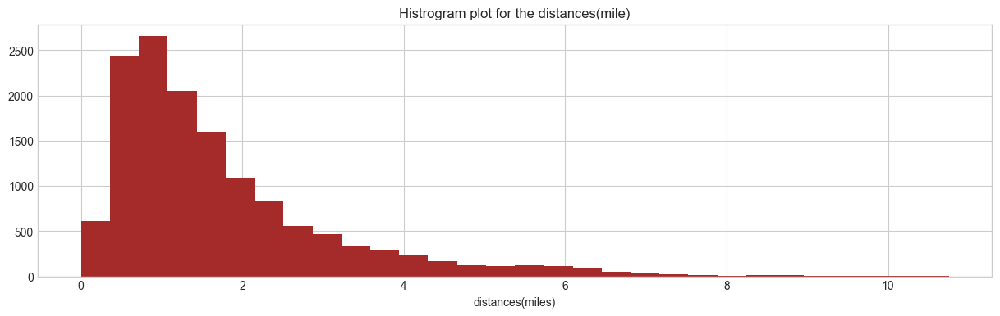

In [82]:
# 4. 4. c. Histrogram plot for the distances(mile) travelled

year2012_insight.distance.hist(bins = 30, figsize =(15,4), color='brown')
plt.xlabel("distances(miles)")
plt.title("Histrogram plot for the distances(mile)")
plt.show()

This histogram gives us a view that most of the rides taken was a short ride

In [83]:
year2012_insight.groupby('passenger_count')[['distance', 'fare_amount']].mean()


,distance,fare_amount
passenger_count,,
0,1.396140,7.432174
1,1.716442,9.557358
2,1.829099,10.093688
3,1.797958,10.133760
4,1.795850,10.371160
5,1.745670,9.835905
6,1.778206,10.044527


In [84]:
print("Average $USD/Miles : {:0.2f}".format(year2012_insight.fare_amount.sum()/year2012_insight.distance.sum()))

Average $USD/Miles : 5.57


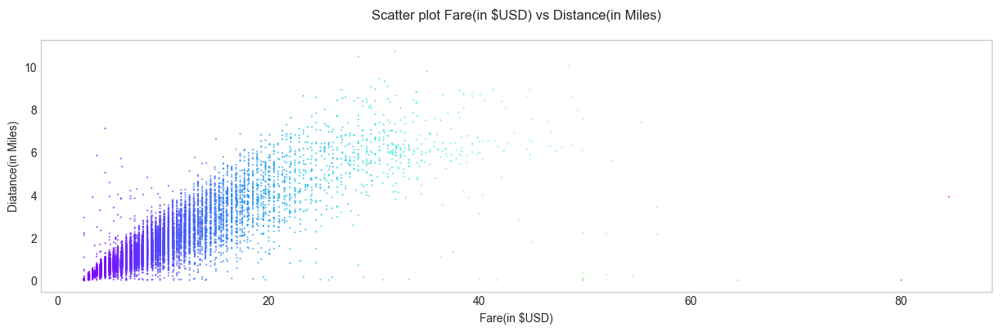

In [89]:
# 4.4.d Scatter plot visualization between Fare(in $USD) vs Distance(in Miles) of year 2012

plt.figure(figsize=(15,4))

plt.scatter(year2012_insight.fare_amount , year2012_insight.distance, c= year2012_insight.fare_amount,
cmap=plt.cm.rainbow, alpha= 0.8, s=1, marker=".")

plt.xlabel('Fare(in $USD)')
plt.ylabel('Diatance(in Miles)')
plt.title('Scatter plot Fare(in $USD) vs Distance(in Miles)\n')
plt.grid(False)
plt.show()

By seeing this data we can sumarize:

There are trips with zero distance but with a non-zero fare. Could this be trips from and to the same location? Predicting these fares will be difficult as there is likely not sufficient information in the dataset.

Overall there seems to be a (linear) relation between distance and fare.

Initial charge for most rides is $2.50 upon entry

And it also seems that someone has paid way too much (>120$)

Note: the calculated distance in the dataset is from point to point. In reality, the distance measured by road is larger.

In [90]:
# remove datapoints with distance < 0.05 miles

print("Old size: ", len(year2012_insight))
train_df = year2012_insight[year2012_insight.distance >= 0.05]

print("New size: ", len(train_df))

Old size:  14099
New size:  14033


5. Model (for the year 2012 only)¶

Due too the large volume of dataset this notebook was constantly crashing, so in here we are only gonna use the data of year 2012
Based on the analysis we can build a BaseLine model that will be

Model : fare_amount(x) ~ [year, hour, distance, passenger_count]

and for that we gonna be using the Linear Regression Model

In [93]:
# 5. 1. Generate the test data
model_data = train_df[['Year', 'Hour', 'distance', 'passenger_count', 'fare_amount']]


In [94]:
model_data.head()

,Year,Hour,distance,passenger_count,fare_amount
30180093,2012,8,0.664630,1,4.5
26925066,2012,23,1.096820,2,5.3
35674234,2012,21,0.842316,1,4.9
27766060,2012,22,1.188561,1,7.5
46023523,2012,0,1.128852,2,6.5


In [95]:
#5. 2. Train, test split of the datasets
X = model_data[['Year', 'Hour', 'distance', 'passenger_count']]
y = model_data[['fare_amount']]


In [96]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42)

In [97]:
#5. 3. Model Run
from sklearn.pipeline import Pipeline
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import StandardScaler

model_lin = Pipeline((
        ("standard_scaler", StandardScaler()),
        ("lin_reg", LinearRegression()),
    ))
model_lin.fit(X_train, y_train)

Pipeline(steps=[('standard_scaler', StandardScaler()),
                ('lin_reg', LinearRegression())])

In [98]:
#5. 4. Model Score
from sklearn.metrics import r2_score

y_test_pred = model_lin.predict(X_test)
score = r2_score(y_test, y_test_pred)
print("The accuracy of our model is {}%".format(round(score, 2) *100))#

The accuracy of our model is 76.0%


In [99]:
# 5. 5. Model Save¶
#Save the model for later use.

import pickle
filename = 'LR_NYC_trainedM.sav'
pickle.dump(model_lin, open(filename, 'wb'))


6. Conclusion
From all these analysis we have made a Linear Regression Model to predict the NYC Taxi Fare price. But though lot more can done and the prediction can be made much better.

